# 1.0 This Notebook is to set up a pipeline for Preprocessing Data, fitting a model, and then evaluating the results

## 1.1 import packages

In [1]:
import datetime
print(datetime.datetime.now())

2021-02-18 19:08:39.128653


In [2]:
pip install pandas_profiling

     |████████████████████████████████| 245kB 7.5MB/s eta 0:00:01
  Using cached https://files.pythonhosted.org/packages/29/c1/24814557f1d22c56d50280771a17307e6bf87b70727d975fd6b2ce6b014a/requests-2.25.1-py2.py3-none-any.whl
     |████████████████████████████████| 81kB 11.0MB/s eta 0:00:01
     |████████████████████████████████| 604kB 11.0MB/s eta 0:00:01
     |████████████████████████████████| 81kB 6.3MB/s eta 0:00:01
     |████████████████████████████████| 8.5MB 6.9MB/s eta 0:00:01
     |████████████████████████████████| 307kB 9.4MB/s eta 0:00:01
     |████████████████████████████████| 3.1MB 2.3MB/s eta 0:00:01
     |████████████████████████████████| 286kB 9.9MB/s eta 0:00:01
     |████████████████████████████████| 1.6MB 2.7MB/s eta 0:00:01
     |████████████████████████████████| 296kB 7.7MB/s eta 0:00:01
     |████████████████████████████████| 2.2MB 3.1MB/s eta 0:00:01
     |████████████████████████████████| 61kB 6.5MB/s eta 0:00:01
     |████████████████████████████████| 4.3MB 5.7M

In [3]:
#data analysis and processing
import pandas as pd
import numpy as np
import random as rnd
import os as system
#from imblearn.under_sampling import RandomUnderSampler

In [3]:
#data visulaization
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import pandas_profiling
from mpl_toolkits.mplot3d import Axes3D


#machine learning supervised algorithms
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier

#machine learning clustering algorithms
from sklearn.neighbors import DistanceMetric
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score 
import scipy.cluster.hierarchy as shc
from sklearn.decomposition import PCA 

#for finetuning
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV


#sklearn accuracy and model evaluation
from sklearn.metrics import mean_squared_error, r2_score, roc_auc_score, make_scorer
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import cross_val_score
from sklearn import metrics
from sklearn.metrics import classification_report

# Simple example for beginers how to adress ""
import numpy as np
from sklearn                        import metrics, svm
from sklearn.linear_model           import LogisticRegression
from sklearn import preprocessing
from sklearn import utils

## 1.2 Import data and analyze

In [7]:
# Combined the customer.csv, loyalty, vehicle, insurance, service
# If it errors out make sure the path below is pointing to the correct datasets in the shared one drive folder
raw = pd.read_csv(r"Data/LabeledCountyFeatures.csv", encoding='latin-1')
raw.head()
df_train = raw.drop(['Unnamed: 0', 'CensusTract'], axis=1) # drop some coolumns from the raw data that are not needed in training data
df_train['minsPerVote'] = 60 * df_train['eff_score'] # eff_score is percent of an hour allocated for each registered voter in the county

stateAvg = 25 # state-wide average time taken to vote. Found to be 12.5 in texas in 2012 election

focusedCounties = df_train.loc[df_train['minsPerVote'] < stateAvg] # counties that allowed for less than the state average
prop_less_than_avg = len(focusedCounties)/len(df_train) # ^ as a percentage

print('{:1f}% of observed counties allow less than {} minutes of polling time per voter'.format(prop_less_than_avg, stateAvg))
citizens_under_avg = sum(focusedCounties['Citizen'])
print('{} Citizens or, {} of Texans in the observed counties are given less than {} minutes to vote'.format(int(citizens_under_avg)+1, citizens_under_avg/sum(df_train['Citizen']), stateAvg))

0.441315% of observed counties allow less than 25 minutes of polling time per voter
252989 Citizens or, 0.4364511502312398 of Texans in the observed counties are given less than 25 minutes to vote


12


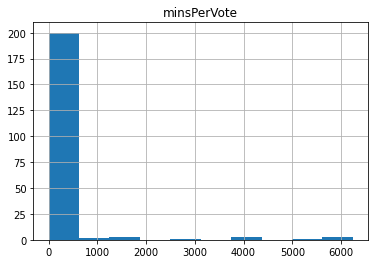

In [10]:

df_train.sort_values(['minsPerVote'], ascending=False).head(25)#[['County','minsPerVote', 'Hispanic', 'Black', 'White', 'Service', 'Professional', 'Locations', 'Workers']]
df_train.hist(column=['minsPerVote'])

samples = df_train.loc[df_train['minsPerVote'] > 999]
print(len(samples))

In [61]:
#analyze which columns are numeric and which are categorical to choose for training down the pipeline

numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
categoricals = ['object']

numeric_columns = df_train.select_dtypes(include=numerics)
categorical_columns = df_train.select_dtypes(include=categoricals)

num_attribs = numeric_columns.columns.values.tolist()
#num_attribs.remove(['Registered Voters',)
cat_attribs = categorical_columns.columns.values.tolist()
#cat_attribs.remove('State_Abbr')

intrests = ['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Poverty',
 'ChildPoverty', 'Professional', 'Service', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome',
 'MeanCommute', 'PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'eff_score', 'minsPerVote']


print (intrests)

print ('**************************************************************')

print (cat_attribs)

['Hispanic', 'White', 'Black', 'Native', 'Asian', 'Pacific', 'Poverty', 'ChildPoverty', 'Professional', 'Service', 'Transit', 'Walk', 'OtherTransp', 'WorkAtHome', 'MeanCommute', 'PrivateWork', 'PublicWork', 'SelfEmployed', 'FamilyWork', 'Unemployment', 'eff_score', 'minsPerVote']
**************************************************************
['County']


In [62]:
# output new df based on choices above and drop na's
# ***note *** might have to have something to clean, right now dropping all nas one team should focus on cleaning the data

df_chosen_features = df_train[intrests + cat_attribs]
df_chosen_features


,Hispanic,White,Black,Native,Asian,Pacific,Poverty,ChildPoverty,Professional,Service,...,WorkAtHome,MeanCommute,PrivateWork,PublicWork,SelfEmployed,FamilyWork,Unemployment,eff_score,minsPerVote,County
0,17.818182,58.945455,21.218182,0.409091,0.654545,0.009091,20.990909,24.509091,23.736364,26.400000,...,3.545455,19.254545,67.318182,26.590909,6.009091,0.090909,5.509091,0.752053,45.123196,anderson
1,49.450000,46.500000,1.275000,0.225000,0.725000,0.000000,10.800000,14.725000,22.925000,14.150000,...,2.650000,20.200000,81.900000,9.775000,7.650000,0.675000,3.575000,0.015041,0.902444,andrews
2,20.641176,61.394118,15.329412,0.182353,1.188235,0.000000,19.658824,29.564706,26.317647,21.082353,...,1.482353,18.423529,76.329412,17.723529,5.917647,0.058824,9.335294,0.702697,42.161848,angelina
3,23.920000,71.180000,1.340000,0.100000,1.360000,0.000000,17.500000,33.420000,32.740000,17.860000,...,6.220000,24.540000,73.140000,12.460000,14.100000,0.300000,5.840000,0.031154,1.869267,aransas
4,7.733333,89.266667,0.533333,1.266667,0.466667,0.000000,9.766667,10.600000,33.766667,13.800000,...,4.666667,21.666667,76.533333,13.866667,9.433333,0.166667,2.966667,0.440506,26.430380,archer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,17.145455,79.354545,1.090909,0.672727,0.354545,0.027273,11.263636,16.836364,28.445455,15.745455,...,5.954545,31.945455,77.100000,14.400000,8.381818,0.127273,7.400000,0.452705,27.162327,wise
209,9.190000,83.600000,4.990000,0.500000,0.630000,0.000000,14.820000,20.420000,29.750000,18.380000,...,5.640000,28.240000,75.230000,15.650000,8.560000,0.510000,8.930000,0.269857,16.191434,wood
210,58.250000,39.650000,0.450000,0.100000,0.600000,0.000000,12.100000,14.750000,28.600000,11.750000,...,1.900000,16.600000,71.900000,18.350000,9.650000,0.150000,7.200000,0.039952,2.397146,yoakum
211,20.500000,76.000000,1.450000,0.475000,0.275000,0.000000,16.400000,23.300000,28.550000,18.075000,...,4.825000,15.325000,73.450000,15.850000,10.450000,0.275000,5.675000,0.083406,5.004344,young


In [63]:
df_chosen_features.dropna(inplace=True)
df_chosen_features.reset_index(inplace=True)

/Users/ethan/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [81]:
# found some nifty thing called pandas-profiling from Steve Thom's notebook. Downloaded it using conda install -c anaconda pandas-profiling
# does more than just df.describe() and df.describe(include='O')
pandas_profiling.ProfileReport(df_chosen_features)

/Users/ethan/opt/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


# 2.0 Start creating a Pipeline

## 2.1 Build prep for pre-processing

## 2.2 Create stratify on labels and create test and train dfs and then downsample it

In [152]:
def normalize(dataset):
    dataNorm=((dataset-dataset.min())/(dataset.max()-dataset.min()))*20
    dataNorm["Hours"]=dataset["Hours"]
    return dataNorm

In [153]:
df_chosen_features=normalize(df_chosen_features)
df_chosen_features.sample(5)

TypeError: unsupported operand type(s) for -: 'str' and 'str'

In [154]:
X = df_chosen_features.drop(["Eff_score"], axis=1)
y = df_chosen_features["Eff_score"]

In [155]:
#y = df_train["Eff_score"]

In [156]:
df_chosen_features['Eff_score']

0      0.752053
1      0.015041
2      0.702697
3      0.031154
4      0.440506
         ...   
208    0.452705
209    0.269857
210    0.039952
211    0.083406
212    0.154941
Name: Eff_score, Length: 213, dtype: float64

In [157]:
X

,df_index,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours,County
0,0,17.818182,58.945455,21.218182,0.409091,0.654545,44392.090909,20.990909,83.627273,5.509091,27030,77,22,12,Anderson County
1,1,49.450000,46.500000,1.275000,0.225000,0.725000,71015.000000,10.800000,78.475000,3.575000,9574,12,1,12,Andrews County
2,2,20.641176,61.394118,15.329412,0.182353,1.188235,43349.411765,19.658824,82.576471,9.335294,51641,112,27,12,Angelina County
3,3,23.920000,71.180000,1.340000,0.100000,1.360000,49725.400000,17.500000,79.000000,5.840000,17333,15,3,12,Aransas County
4,4,7.733333,89.266667,0.533333,1.266667,0.466667,60725.000000,9.766667,86.466667,2.966667,6320,29,8,12,Archer County
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,208,17.145455,79.354545,1.090909,0.672727,0.354545,58960.090909,11.263636,81.481818,7.400000,41749,75,21,12,Wise County
209,209,9.190000,83.600000,4.990000,0.500000,0.630000,44648.900000,14.820000,79.800000,8.930000,29838,61,11,12,Wood County
210,210,58.250000,39.650000,0.450000,0.100000,0.600000,56363.500000,12.100000,80.450000,7.200000,4205,7,2,12,Yoakum County
211,211,20.500000,76.000000,1.450000,0.475000,0.275000,45304.250000,16.400000,82.225000,5.675000,11510,16,5,12,Young County


In [158]:
df_chosen_features=df_chosen_features.drop(["Eff_score"], axis=1)

In [159]:
from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [160]:
X_train.shape

(170, 15)

In [161]:
X_test1=X_test['County']

In [205]:
X_test1

,df_index,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours,Actual Eff_score,Predicted Eff_score
108,108,21.03,65.64,9.82,0.42,0.76,58745.17,15.88,81.89,9.09,72976,125,29,12,0.60,0.16
191,191,32.69,51.71,7.72,0.17,5.38,66877.99,17.40,73.03,6.07,787670,874,143,12,1.90,0.50
106,106,24.22,64.67,8.83,0.40,0.13,43294.20,18.76,78.72,3.96,9565,32,10,12,0.40,0.28
107,107,49.35,45.15,5.05,0.05,0.15,50402.25,22.12,82.05,6.12,8071,43,14,12,0.90,0.56
51,51,52.08,40.95,5.25,0.25,0.75,41306.50,17.10,77.48,9.38,7065,28,9,12,0.43,0.70
33,33,19.20,66.28,10.72,0.36,1.44,60482.40,14.04,86.40,9.12,26882,62,15,12,0.42,0.10
59,59,56.48,36.83,4.28,0.30,0.76,57245.86,13.60,80.93,5.12,76573,111,26,12,0.45,0.43
152,152,14.40,72.20,6.10,0.50,0.50,50893.00,13.10,80.90,7.40,1414,20,4,12,0.68,0.94
4,4,7.73,89.27,0.53,1.27,0.47,60725.00,9.77,86.47,2.97,6320,29,8,12,0.44,0.26
31,31,9.30,87.30,0.85,0.70,0.30,67111.50,6.75,90.45,1.35,4264,24,7,12,0.47,0.34


In [203]:
X_test=round(X_test,2)
X_test['Actual Eff_score']=round(y_test, 2)
X_test['Predicted Eff_score']=abs(y_pred.round(2))

#X_test.drop(["Eff_score","df_index"],axis=1).head(20)

X_test[['Actual Eff_score','Predicted Eff_score','Hispanic','White', 'Black', 'Native', 'Asian', 'Income', 'Poverty',
       'Drive', 'Unemployment', 'Voters', 'Workers', 'Locations', 'Hours']].head(20)
#X_test.drop(["index"],axis=1)

,Actual Eff_score,Predicted Eff_score,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours
108,0.60,0.84,21.03,65.64,9.82,0.42,0.76,58745.17,15.88,81.89,9.09,72976,125,29,12
191,1.90,2.59,32.69,51.71,7.72,0.17,5.38,66877.99,17.40,73.03,6.07,787670,874,143,12
106,0.40,1.47,24.22,64.67,8.83,0.40,0.13,43294.20,18.76,78.72,3.96,9565,32,10,12
107,0.90,2.89,49.35,45.15,5.05,0.05,0.15,50402.25,22.12,82.05,6.12,8071,43,14,12
51,0.43,3.67,52.08,40.95,5.25,0.25,0.75,41306.50,17.10,77.48,9.38,7065,28,9,12
33,0.42,0.52,19.20,66.28,10.72,0.36,1.44,60482.40,14.04,86.40,9.12,26882,62,15,12
59,0.45,2.26,56.48,36.83,4.28,0.30,0.76,57245.86,13.60,80.93,5.12,76573,111,26,12
152,0.68,4.87,14.40,72.20,6.10,0.50,0.50,50893.00,13.10,80.90,7.40,1414,20,4,12
4,0.44,1.38,7.73,89.27,0.53,1.27,0.47,60725.00,9.77,86.47,2.97,6320,29,8,12
31,0.47,1.77,9.30,87.30,0.85,0.70,0.30,67111.50,6.75,90.45,1.35,4264,24,7,12


## 2.3 Train Supervised models ( for loyalty prediction)

In [165]:
y_test


108     0.596086
191     1.904077
106     0.401464
107     0.895056
51      0.428025
33      0.415148
59      0.452274
152     0.678925
4       0.440506
31      0.472795
118     0.321302
39      0.369666
93      0.868545
69     96.880228
161     0.400626
112     0.954057
94      1.149165
97      1.309091
151     0.165612
38      0.101713
44      0.542373
177     0.522250
84      0.193062
18      0.914807
158     0.773918
35      0.136523
73      0.646003
122     1.225280
19      0.188322
62      0.197036
169     0.321260
180     0.095514
34      0.809150
11      0.164807
29      1.807288
0       0.752053
159     0.279325
148     1.240043
130     0.464802
28      0.049896
16      3.614754
197     1.097891
194     0.425458
Name: Eff_score, dtype: float64

### Helper Functions to plot accuracy and evaluation metrics

In [166]:
lab_enc = preprocessing.LabelEncoder()
training_scores_encoded = lab_enc.fit_transform(y_train)
testing_scores_encoded = lab_enc.fit_transform(y_test)
print(training_scores_encoded)
print(utils.multiclass.type_of_target(y_train))
print(utils.multiclass.type_of_target(y_train.astype('int')))
print(utils.multiclass.type_of_target(training_scores_encoded))

[162  91 127  60  67  46  24 124  20 108 137  58 101 136  27  26  82 153
 118  22 140 156  65  83  74  25 130  61  10 155 150  23  88 115 169 139
 125  40 107  63   4 106  49 142  21  73  94  14  89  71  55  84 135  56
 138 145  29 166 161  11 133  86 102   9 128  53  18  42 144  72  77 167
 148 141   5  37 157 134 143 120 160 114  70 110  34 131  19  41  95  62
 152  38 122 126 123 159 112  97 132 129  80 103  48  54  79  98  39   6
 116  35  99 151  31  78  43  93  75  36  50  51 168 113 165 100   3 104
   7  76  28  33  16  66 121   8   2 105  32   1 149 163 111   0 117  47
  90 146  44  64 158 164  59  85  52  69  15  81  17 119  92  13 109 154
 147  87  68  96  12  57  45  30]
continuous
multiclass
multiclass


In [171]:

#X_train=X_train.drop(["County"],axis=1)
#X_test=X_test.drop(["County"],axis=1)

X_train.drop(["df_index"],axis=1)

,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours
47,53.933333,40.966667,3.500000,0.000000,0.000000,37941.666667,22.733333,83.433333,9.500000,3540,12,709,12
201,15.483333,63.350000,18.400000,0.366667,1.616667,50458.833333,13.850000,83.316667,4.983333,23238,68,15,12
27,43.480000,48.460000,3.020000,0.060000,2.780000,51707.600000,17.840000,80.200000,6.360000,12491,52,16,12
58,16.220000,79.880000,2.300000,0.180000,0.260000,34550.600000,18.340000,83.420000,4.540000,10860,32,9,12
40,28.200000,58.700000,12.700000,0.160000,0.160000,45961.400000,15.200000,87.400000,3.980000,13445,37,11,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,20.397222,64.375000,10.480556,0.608333,1.747222,44210.666667,20.438889,81.472222,6.841667,79116,135,27,12
137,49.700000,47.012500,1.612500,0.412500,0.237500,54736.500000,15.400000,81.575000,6.262500,31508,35,7,12
72,24.316667,54.280303,16.657576,0.304545,2.787879,57612.045455,17.351515,77.083333,9.004545,206534,151,35,12
140,23.800000,64.957143,8.157143,0.128571,0.485714,41657.285714,16.942857,76.942857,8.985714,14851,40,8,12


In [179]:
X_test1.drop(["Actual Eff_score","Predicted Eff_score","df_index"],axis=1)

,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours
108,21.03,65.64,9.82,0.42,0.76,58745.17,15.88,81.89,9.09,72976,125,29,12
191,32.69,51.71,7.72,0.17,5.38,66877.99,17.40,73.03,6.07,787670,874,143,12
106,24.22,64.67,8.83,0.40,0.13,43294.20,18.76,78.72,3.96,9565,32,10,12
107,49.35,45.15,5.05,0.05,0.15,50402.25,22.12,82.05,6.12,8071,43,14,12
51,52.08,40.95,5.25,0.25,0.75,41306.50,17.10,77.48,9.38,7065,28,9,12
33,19.20,66.28,10.72,0.36,1.44,60482.40,14.04,86.40,9.12,26882,62,15,12
59,56.48,36.83,4.28,0.30,0.76,57245.86,13.60,80.93,5.12,76573,111,26,12
152,14.40,72.20,6.10,0.50,0.50,50893.00,13.10,80.90,7.40,1414,20,4,12
4,7.73,89.27,0.53,1.27,0.47,60725.00,9.77,86.47,2.97,6320,29,8,12
31,9.30,87.30,0.85,0.70,0.30,67111.50,6.75,90.45,1.35,4264,24,7,12


In [174]:
X_test1=X_test

In [184]:
from sklearn.linear_model import LinearRegression 
regr = LinearRegression()

regr.fit(X_train, y_train) 
#print(regr.score(X_test, y_test)*100)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
         normalize=False)

In [197]:
X_train

,df_index,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours
47,47,53.933333,40.966667,3.500000,0.000000,0.000000,37941.666667,22.733333,83.433333,9.500000,3540,12,709,12
201,201,15.483333,63.350000,18.400000,0.366667,1.616667,50458.833333,13.850000,83.316667,4.983333,23238,68,15,12
27,27,43.480000,48.460000,3.020000,0.060000,2.780000,51707.600000,17.840000,80.200000,6.360000,12491,52,16,12
58,58,16.220000,79.880000,2.300000,0.180000,0.260000,34550.600000,18.340000,83.420000,4.540000,10860,32,9,12
40,40,28.200000,58.700000,12.700000,0.160000,0.160000,45961.400000,15.200000,87.400000,3.980000,13445,37,11,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,203,20.397222,64.375000,10.480556,0.608333,1.747222,44210.666667,20.438889,81.472222,6.841667,79116,135,27,12
137,137,49.700000,47.012500,1.612500,0.412500,0.237500,54736.500000,15.400000,81.575000,6.262500,31508,35,7,12
72,72,24.316667,54.280303,16.657576,0.304545,2.787879,57612.045455,17.351515,77.083333,9.004545,206534,151,35,12
140,140,23.800000,64.957143,8.157143,0.128571,0.485714,41657.285714,16.942857,76.942857,8.985714,14851,40,8,12


In [198]:
X_test1.drop(["Actual Eff_score","Predicted Eff_score"],axis=1)


,df_index,Hispanic,White,Black,Native,Asian,Income,Poverty,Drive,Unemployment,Voters,Workers,Locations,Hours
108,108,21.03,65.64,9.82,0.42,0.76,58745.17,15.88,81.89,9.09,72976,125,29,12
191,191,32.69,51.71,7.72,0.17,5.38,66877.99,17.40,73.03,6.07,787670,874,143,12
106,106,24.22,64.67,8.83,0.40,0.13,43294.20,18.76,78.72,3.96,9565,32,10,12
107,107,49.35,45.15,5.05,0.05,0.15,50402.25,22.12,82.05,6.12,8071,43,14,12
51,51,52.08,40.95,5.25,0.25,0.75,41306.50,17.10,77.48,9.38,7065,28,9,12
33,33,19.20,66.28,10.72,0.36,1.44,60482.40,14.04,86.40,9.12,26882,62,15,12
59,59,56.48,36.83,4.28,0.30,0.76,57245.86,13.60,80.93,5.12,76573,111,26,12
152,152,14.40,72.20,6.10,0.50,0.50,50893.00,13.10,80.90,7.40,1414,20,4,12
4,4,7.73,89.27,0.53,1.27,0.47,60725.00,9.77,86.47,2.97,6320,29,8,12
31,31,9.30,87.30,0.85,0.70,0.30,67111.50,6.75,90.45,1.35,4264,24,7,12


In [200]:

predicted = regr.predict(X_test1.drop(["Actual Eff_score","Predicted Eff_score"],axis=1))
 
y_test

108     0.596086
191     1.904077
106     0.401464
107     0.895056
51      0.428025
33      0.415148
59      0.452274
152     0.678925
4       0.440506
31      0.472795
118     0.321302
39      0.369666
93      0.868545
69     96.880228
161     0.400626
112     0.954057
94      1.149165
97      1.309091
151     0.165612
38      0.101713
44      0.542373
177     0.522250
84      0.193062
18      0.914807
158     0.773918
35      0.136523
73      0.646003
122     1.225280
19      0.188322
62      0.197036
169     0.321260
180     0.095514
34      0.809150
11      0.164807
29      1.807288
0       0.752053
159     0.279325
148     1.240043
130     0.464802
28      0.049896
16      3.614754
197     1.097891
194     0.425458
Name: Eff_score, dtype: float64

In [201]:
y_pred=predicted
y_pred.round(2)

array([-0.84, -2.59, -1.47,  2.89,  3.67,  0.52,  2.26, -4.87,  1.38,
        1.77,  2.8 , -3.68,  4.34, 53.26,  1.52,  3.65,  1.21, -4.59,
        2.4 ,  3.49, -3.59, -0.98,  3.78, -4.68, -1.61, -0.29,  2.93,
        1.85,  0.13,  0.82, -1.59,  0.81, -1.43,  3.01,  7.01, -2.34,
       -1.37,  2.46,  0.12,  1.8 , -2.6 ,  2.8 ,  1.46])

#### Save all models into a file so you don't have to run all the stuff from above again (note pls do this as it takes a while to train some of these models

import pickle